<a href="https://colab.research.google.com/github/sethkipsangmutuba/Exploratory-Data-Analysis/blob/main/EDA2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<a target="_blank" href="https://colab.research.google.com/github/esaruhann/DS4SDGs/blob/Data_Manupilation/02-DS4SDGS-Exploratory%20Data%20Analysis_v0.3.1.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

# 4. Data Cleaning

Data cleaning is an essential part of any data analysis process. It involves preparing and refining the dataset to ensure it is accurate, consistent, and ready for meaningful insights. Below are the key aspects of effective data cleaning:

* Identify missing values and outliers.
* Check for plausibility and errors, such as typos or inconsistencies.
* Identify highly correlated variables or variables with very low variance.
* Spot variables with unusual names or values that might need further inspection.
* Verify variable classes (e.g., characters, factors, integers) to ensure correct data types.
* Rename variables or values, especially for those that are numerous or particularly important.
* Review overall patterns using statistical and numerical summaries.

The Pandas functions discussed earlier are invaluable for understanding your data and implementing appropriate cleaning steps.
<br>

Data cleaning is not just technical. It requires understanding the dataset's context and making thoughtful decisions about how to handle inconsistencies or gaps.
Trade-offs are inevitable. Every choice in data cleaning—whether to remove, impute, or transform data—has implications for subsequent analysis.

## 4.1. Handling Missing Values

Missing data is one of the most frequent issues encountered in datasets. For instance, imagine conducting a customer segmentation analysis where 50% of the records lack address information. This could skew the results, leading to a biased analysis that inaccurately shows no customers in certain regions. This is why identifying and handling missing data is a critical step in the data cleaning process.

Blank space, None, NaN, and NaT are the general types of missing data.

In the sections below, you'll learn how to check for missing data in your dataset and address it effectively to ensure accurate and reliable analysis.

### 4.1.1. df.isna() and df.isnull(): Check for Missing Values.

Pandas provides two useful methods to identify missing data in a DataFrame:`df.isna()` and `df.isnull()`. Both methods are functionally identical and can be used interchangeably. Here's how they work:

`df.isna()`

* Returns a DataFrame of the same shape as the original.
* Each cell contains True if the corresponding value is missing (NaN or None), and False otherwise.

`df.isnull()`

* Similar to isna(), this method returns a DataFrame where each cell is either True or False.
* A cell is marked as True if it contains missing data, such as, NaN (in numerical arrays), None or NaN (in object arrays), NaT (in datetime-like arrays).

For both methods, missing values are represented by True, while non-missing values are represented by False. These methods are fundamental for identifying and addressing missing data in your dataset.

In [ ]:
# our sample data set has no missing values
df.isna()

,area,year,life_expectancy_at_birth
0,False,False,False
1,False,False,False
2,False,False,False
3,False,False,False
4,False,False,False
5,False,False,False
6,False,False,False
7,False,False,False
8,False,False,False
9,False,False,False


In [ ]:
# check if dataset has null values
print(df.isnull())

        area   year  life_expectancy_at_birth
0      False  False                     False
1      False  False                     False
2      False  False                     False
3      False  False                     False
4      False  False                     False
5      False  False                     False
6      False  False                     False
7      False  False                     False
8      False  False                     False
9      False  False                     False
10     False  False                     False
11     False  False                     False
12     False  False                     False
13     False  False                     False
14     False  False                     False
15     False  False                     False
16     False  False                     False
17     False  False                     False
18     False  False                     False
19     False  False                     False
20     False  False               

In [ ]:
# print the number of missing values per column
print(df.isnull().sum())


area                        0
year                        0
life_expectancy_at_birth    0
dtype: int64


### 4.1.2. df.dropna(): Remove Missing Values.

`df.dropna()` function identifies and removes rows or columns with missing values from a DataFrame. Missing values are considered as entries like np.nan or pd.NaT (Null/None).

In [ ]:
df = df.dropna()  # Removes rows or columns with missing values

### 4.1.3. df.drop(): *Remove* Specified Rows/Columns

`df.drop()` function is used to remove single or multiple rows and columns from the dataset DataFrame. It drops the specified labels from rows or columns.



In [ ]:
df_copy = df.copy() #Create a copy of our dataset
print(df_copy.head())


#apply drop() method to remove the year column
df_copy = df_copy.drop(columns=['year'])  # Drops the 'year' column

print(df_copy.head())


          area  year  life_expectancy_at_birth
0  afghanistan  1800                 28.211000
1  afghanistan  1917                 27.012140
2  afghanistan  1918                  7.045063
3  afghanistan  1919                 26.991647
4  afghanistan  1950                 26.674000
          area  life_expectancy_at_birth
0  afghanistan                 28.211000
1  afghanistan                 27.012140
2  afghanistan                  7.045063
3  afghanistan                 26.991647
4  afghanistan                 26.674000


### 4.1.4. df.fillna(): Replace Null Values in DataFrame

`df.fillna()` function is used to replace null values (NaN or NA) in a dataset with a specified value or by applying a particular method.

Since our current dataset does not contain any null values, we will demonstrate this function using a simple example in the code cell below.

In this example:

* Missing SDG Index scores are filled with the average of the existing scores.
* Missing Renewable Energy percentages are replaced with a specific value, assumed to be the global average (26%).

In [ ]:
import pandas as pd

# Create dictionary with data
data = {
    'Country': ['United States', 'China', 'India', 'Brazil'],
    'SDG Index Score (2022)': [80.0, None, 58.6, None],
    'Renewable Energy (%)': [12.7, 28.5, None, 46.0]
}

# Create DataFrame
df_1 = pd.DataFrame(data)

print("Original DataFrame")
print(df_1)


# Fill missing SDG Index scores with mean value
df_1['SDG Index Score (2022)'] = df_1['SDG Index Score (2022)'].fillna(df_1['SDG Index Score (2022)'].mean())

# Fill missing Renewable Energy with global average (26)
df_1['Renewable Energy (%)'] = df_1['Renewable Energy (%)'].fillna(26)

print("\nDataFrame after filling missing values")
print(df_1)


Original DataFrame
         Country  SDG Index Score (2022)  Renewable Energy (%)
0  United States                    80.0                  12.7
1          China                     NaN                  28.5
2          India                    58.6                   NaN
3         Brazil                     NaN                  46.0

DataFrame after filling missing values
         Country  SDG Index Score (2022)  Renewable Energy (%)
0  United States                    80.0                  12.7
1          China                    69.3                  28.5
2          India                    58.6                  26.0
3         Brazil                    69.3                  46.0


**Additional Info: Missing Data Visualization**


When working with a dataset containing numerous missing values, visualization can quickly reveal the dataset's completeness. The Missingno package offers user-friendly functions to generate visual summaries of missing data, making it easier to identify patterns or issues.

For more details on using the Missingno package, check out the [official documentation.](https://pypi.org/project/missingno/)



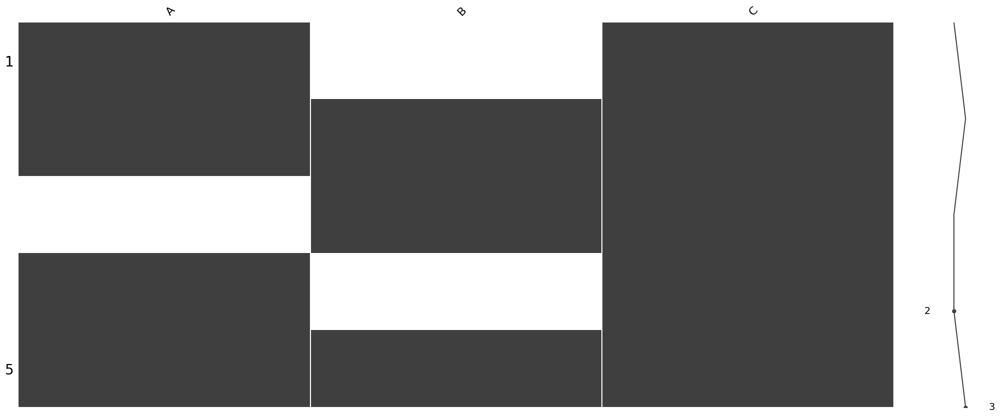

In [ ]:
import pandas as pd
import missingno as msno
import matplotlib.pyplot as plt

# Create a sample dataset with missing values
data = {
    'A': [1, 2, None, 4, 5],
    'B': [None, 2, 3, None, 5],
    'C': [1, 2, 3, 4, 5]
}

df_ms = pd.DataFrame(data)

# Visualize missing data using missingno
msno.matrix(df_ms)
plt.show()


## 4.2. Handling Duplicate Data


Identifying and handling duplicate values is a crucial step in the Exploratory Data Analysis (EDA) process. Duplicate entries can distort the analysis by misrepresenting data patterns, potentially leading to biased or incorrect conclusions.

The Pandas library offers two essential functions to address this issue:

* duplicated(): Identifies duplicate rows in the dataset.
* drop_duplicates(): Removes duplicate entries to ensure data integrity.

Using these functions in tandem helps maintain the accuracy and reliability of your analysis.


### 4.2.1. df.duplicated(): Check for Duplicates

This function returns a Boolean Series denoting duplicate rows. The Boolean series is True for every row of data that is a duplicate, and False otherwise. Here's an example using mini-version of our dataset:

In [ ]:

# Create a dictionary of data
data1 = {
    'Area': ['United States', 'United States', 'India', 'India', 'Brazil', 'Brazil'],
    'Year': [2022, 2022, 2022, 2022, 2022, 2023],
    'Life Expectancy': [78.5, 78.5, 69.4, 69.4, 75.7, 75.8]
}

# Create a DataFrame from the dictionary
df_2 = pd.DataFrame(data1)


print("Original DataFrame")
print(df_2)


# making a bool series
bool_series = df_2.duplicated()

print("Boolean Series")
print(bool_series)


# Use duplicated() to check for duplicate rows
print("\nDuplicate Rows")
print(df_2[bool_series])


Original DataFrame
            Area  Year  Life Expectancy
0  United States  2022             78.5
1  United States  2022             78.5
2          India  2022             69.4
3          India  2022             69.4
4         Brazil  2022             75.7
5         Brazil  2023             75.8
Boolean Series
0    False
1     True
2    False
3     True
4    False
5    False
dtype: bool

Duplicate Rows
            Area  Year  Life Expectancy
1  United States  2022             78.5
3          India  2022             69.4



### 4.2.2. drop_duplicates(): Drop Duplicates

The df.drop_duplicates() function is used to remove duplicate rows from the DataFrame. By default, it keeps the first occurrence of the duplicate and removes the subsequent ones. However, you can specify whether to keep the first or last occurrence using the keep parameter.


In [ ]:
# Use drop_duplicates() to drop the duplicate rows
df_dropped = df_2.drop_duplicates()

print("\nDataFrame after dropping duplicates")
print(df_dropped)


DataFrame after dropping duplicates
            Area  Year  Life Expectancy
0  United States  2022             78.5
2          India  2022             69.4
4         Brazil  2022             75.7
5         Brazil  2023             75.8


## 4.3. Data Transformation/Manipulation

After cleaning the dataset, addressing missing values, and removing duplicates, you gain a clearer understanding of the data's content and distribution. However, the data may still not be in the ideal format for your specific task. This is where data transformation and manipulation come into play.

The Pandas library offers a comprehensive set of powerful functions to help restructure, manipulate, and transform your data into formats that are better suited for further analysis. Let’s explore how these functions can streamline this critical stage of the EDA process.




### 4.3.1. df.assign(): Adds New Columns to DataFrame

The `df.assign()` new columns to the DataFrame and returns a new object with all original columns in addition to the new ones.

In [ ]:
#combine area and year and add as a new column 'area_year'
df = df.assign(area_year = df['area'] + "_" + df['year'].astype(str))
print(df.head())


          area  year  life_expectancy_at_birth         area_year
0  afghanistan  1800                 28.211000  afghanistan_1800
1  afghanistan  1917                 27.012140  afghanistan_1917
2  afghanistan  1918                  7.045063  afghanistan_1918
3  afghanistan  1919                 26.991647  afghanistan_1919
4  afghanistan  1950                 26.674000  afghanistan_1950


### 4.3.2. df.rename(): Alters axis labels.

`df.rename()` allows you to change the names of the labels for your DataFrame's rows and/or columns.

For example: If you want to rename the `life_expectancy_with_interpolations` column, you can do it as shown in the cell below. Also, `area` column label has been renamed.

In [ ]:
df = df.rename(columns={"life_expectancy_at_birth": "Life Expectancy", "area": "Area"})
print(df.head())


          Area  year  Life Expectancy         area_year
0  afghanistan  1800        28.211000  afghanistan_1800
1  afghanistan  1917        27.012140  afghanistan_1917
2  afghanistan  1918         7.045063  afghanistan_1918
3  afghanistan  1919        26.991647  afghanistan_1919
4  afghanistan  1950        26.674000  afghanistan_1950


### 4.3.3. df.apply(): Apply a Function along an Axis

`df.apply()` permits you to apply a function along one of the axis of the DataFrame. That is, the function is applied to every element in the specified axis.

For example, to convert each value of the 'Life Expectancy' column from years to months in our dataset, we can use the `df.apply()` function as shown in cell below:

In [ ]:
# life expectancy is now in months
df['Life Expectancy'] = df['Life Expectancy'].apply(lambda x: x*12)
print(df.head())


          Area  year  Life Expectancy         area_year
0  afghanistan  1800       338.532000  afghanistan_1800
1  afghanistan  1917       324.145680  afghanistan_1917
2  afghanistan  1918        84.540753  afghanistan_1918
3  afghanistan  1919       323.899760  afghanistan_1919
4  afghanistan  1950       320.088000  afghanistan_1950


### 4.3.4. df.astype(): Converting Columns from One Data Type to Another

In Chapter 1, we introduced data types. Now, let's learn how to change a column's data type using the `astype()` function. This function allows you to convert a column from its current data type to another, depending on your requirements.

As the size of a DataFrame increases, the data type of a column can impact performance during calculations by affecting memory usage and processing efficiency.

`df.astype()` function enables you to cast a Pandas object to a specified data type.

For example: We can convert years from integers to float datatype as shown in cell below:

In [ ]:
# Data type of years before conversion
print(df['year'].dtype)

# Converts year to integer data type
df['year'] = df['year'].astype(float)

# Datatype of years after conversion
print(df['year'].dtype)


int64
float64



Besides `astype()`function, here are three other functions to consider when converting types in pandas:

- **to_numeric()** provides functionality to safely convert non-numeric types (e.g. strings) to a suitable numeric type.

- **infer_objects()** a utility method to convert object columns holding Python objects to a pandas type if possible.

- **convert_dtypes()** convert DataFrame columns to the "best possible" dtype that supports pd.NA.



### 4.3.5. df.tolist(): Convert DataFrame to a List

Sometimes, we hope to convert the content from a dataset into a list for further manipulation. `tolist()` function is recommended for the purpose.

In [ ]:
# tolist usage:
data_lst = df.values.tolist()
print(data_lst[:3]) #print the first three elements in the list


[['afghanistan', 1800.0, 338.532, 'afghanistan_1800'], ['afghanistan', 1917.0, 324.1456799999993, 'afghanistan_1917'], ['afghanistan', 1918.0, 84.54075252031276, 'afghanistan_1918']]


### 4.3.6. df.query(): Query DataFrame Columns

 `df.query()` queries the columns of a DataFrame with a boolean expression.

For example: In the example below, "Area == 'iceland'" is the boolean expression. It will be `True` for rows where the 'Area' is equal to 'iceland', and `False` otherwise.


In [ ]:
print(df.query("Area == 'iceland'"))

          Area    year  Life Expectancy     area_year
13762  iceland  1735.0       467.483172  iceland_1735
13763  iceland  1736.0       526.183876  iceland_1736
13764  iceland  1737.0       469.856762  iceland_1737
13765  iceland  1738.0       416.477635  iceland_1738
13766  iceland  1739.0       323.051948  iceland_1739
13767  iceland  1740.0       372.193423  iceland_1740
13768  iceland  1741.0       424.776790  iceland_1741
13769  iceland  1742.0       270.862656  iceland_1742
13770  iceland  1743.0       462.027779  iceland_1743
13771  iceland  1744.0       464.975728  iceland_1744
13772  iceland  1745.0       496.313847  iceland_1745
13773  iceland  1746.0       449.639980  iceland_1746
13774  iceland  1747.0       405.902370  iceland_1747
13775  iceland  1748.0       471.804823  iceland_1748
13776  iceland  1749.0       472.908020  iceland_1749
13777  iceland  1750.0       484.324228  iceland_1750
13778  iceland  1751.0       426.627815  iceland_1751
13779  iceland  1752.0      

### 4.3.7. df.sort_values(): Sorts a DataFrame along either axis.

`df.sort_values()` sorts a DataFrame along a specified axis based on the values in one or more columns.



In [ ]:
df = df.sort_values(by='Life Expectancy')
print(df.head())


                   Area    year  Life Expectancy              area_year
26541             samoa  1918.0        12.000000             samoa_1918
9749               fiji  1875.0        12.000000              fiji_1875
10778  french_polynesia  1918.0        12.000000  french_polynesia_1918
31630           tunisia  1819.0        18.000000           tunisia_1819
13812           iceland  1785.0        25.724735           iceland_1785


### 4.3.8. df.sample(): Returns a random sample of items from an axis of object.


`df.sample()` selects a random sample of rows or columns from a DataFrame.




In [ ]:
print(df.sample(n=10))  # Select 10 random rows from the DataFrame

                 Area    year  Life Expectancy            area_year
18779   macedonia_fyr  2055.0          978.828   macedonia_fyr_2055
10595          france  2080.0         1086.360          france_2080
23151           niger  2067.0          848.496           niger_2067
16282           kenya  2093.0          946.920           kenya_2093
33861         vanuatu  2019.0          878.148         vanuatu_2019
22328     netherlands  2027.0          993.936     netherlands_2027
33086  united_kingdom  1960.0          853.200  united_kingdom_1960
8106          denmark  1976.0          885.360         denmark_1976
33112  united_kingdom  1986.0          899.400  united_kingdom_1986
31955          turkey  2086.0         1052.472          turkey_2086


### 4.3.9. df.merge():  


The `pd.merge()` function combines two DataFrames based on common columns or indices. The type of merge is determined by the how parameter.

Merge Types:
- **left:** Includes only the keys from the left DataFrame.
- **right:** Includes only the keys from the right DataFrame.
- **inner:** Includes the intersection of keys from both DataFrames.
- **outer:** Includes the union of keys from both DataFrames.

Each method will be demonstrated using DataFrames with the columns "area", "year", and "life_expectancy".

In [ ]:
import pandas as pd

# Create two sample dataframes
df1 = pd.DataFrame({
    'area': ['Area1', 'Area2', 'Area3', 'Area4'],
    'year': [2001, 2002, 2003, 2004],
    'life_expectancy': [75, 78, 82, 85]
})

df2 = pd.DataFrame({
    'area': ['Area3', 'Area4', 'Area5', 'Area6'],
    'year': [2003, 2004, 2005, 2006],
    'life_expectancy': [83, 86, 79, 80]
})

print("DataFrame 1:")
print(df1)

print("\nDataFrame 2:")
print(df2)


DataFrame 1:
    area  year  life_expectancy
0  Area1  2001               75
1  Area2  2002               78
2  Area3  2003               82
3  Area4  2004               85

DataFrame 2:
    area  year  life_expectancy
0  Area3  2003               83
1  Area4  2004               86
2  Area5  2005               79
3  Area6  2006               80


In [ ]:
# Left Merge

left_merge = df1.merge(df2, on=['area', 'year'], how='left', suffixes=('_df1', '_df2'))
print(left_merge)


    area  year  life_expectancy_df1  life_expectancy_df2
0  Area1  2001                   75                  NaN
1  Area2  2002                   78                  NaN
2  Area3  2003                   82                 83.0
3  Area4  2004                   85                 86.0


In [ ]:
# Right Merge

right_merge = df1.merge(df2, on=['area', 'year'], how='right', suffixes=('_df1', '_df2'))
print(right_merge)


    area  year  life_expectancy_df1  life_expectancy_df2
0  Area3  2003                 82.0                   83
1  Area4  2004                 85.0                   86
2  Area5  2005                  NaN                   79
3  Area6  2006                  NaN                   80


In [ ]:
# Inner Merge

inner_merge = df1.merge(df2, on=['area', 'year'], how='inner', suffixes=('_df1', '_df2'))
print(inner_merge)


    area  year  life_expectancy_df1  life_expectancy_df2
0  Area3  2003                   82                   83
1  Area4  2004                   85                   86


In [ ]:
# Outer Merge:
outer_merge = df1.merge(df2, on=['area', 'year'], how='outer', suffixes=('_df1', '_df2'))
print(outer_merge)


    area  year  life_expectancy_df1  life_expectancy_df2
0  Area1  2001                 75.0                  NaN
1  Area2  2002                 78.0                  NaN
2  Area3  2003                 82.0                 83.0
3  Area4  2004                 85.0                 86.0
4  Area5  2005                  NaN                 79.0
5  Area6  2006                  NaN                 80.0


### 4.3.10. Filtering <a class="anchor" id="three-one-four"></a>

Filtering data is an essential step in data analysis, enabling the extraction of specific subsets of a dataset based on defined conditions.


<br>


Example: Return rows where life expectancy is greater than 76.

In [ ]:
df = df.rename(columns={"Life Expectancy" :"life_expectancy_at_birth" , "Area": "area"})

In [ ]:
# Filtering based on a single condition

filtered_df = df[df['life_expectancy_at_birth'] > 76]

filtered_df

,area,year,life_expectancy_at_birth,area_year
31631,tunisia,1820.0,78.000000,tunisia_1820
9752,fiji,1918.0,79.387582,fiji_1918
31806,turkey,1915.0,84.000000,turkey_1915
2,afghanistan,1918.0,84.540753,afghanistan_1918
20110,mauritius,1854.0,90.000000,mauritius_1854
16291,kiribati,1890.0,96.000000,kiribati_1890
31311,tonga,1893.0,96.000000,tonga_1893
9577,ethiopia,1891.0,96.000000,ethiopia_1891
15963,kazakhstan,1932.0,96.000000,kazakhstan_1932
14190,india,1918.0,97.306039,india_1918


Example: Return rows for zimbabwe from the year 2010.

In [ ]:
# Filtering based on multiple conditions

filtered_df = df[(df['area'] == 'zimbabwe') & (df['year'] > 2010)]

filtered_df

,area,year,life_expectancy_at_birth,area_year
35106,zimbabwe,2011.0,672.480,zimbabwe_2011
35107,zimbabwe,2012.0,697.704,zimbabwe_2012
35108,zimbabwe,2013.0,718.452,zimbabwe_2013
35109,zimbabwe,2014.0,733.980,zimbabwe_2014
35110,zimbabwe,2015.0,744.204,zimbabwe_2015
35111,zimbabwe,2016.0,749.868,zimbabwe_2016
35112,zimbabwe,2017.0,752.784,zimbabwe_2017
35113,zimbabwe,2018.0,754.584,zimbabwe_2018
35114,zimbabwe,2019.0,756.036,zimbabwe_2019
35115,zimbabwe,2020.0,757.752,zimbabwe_2020


### 4.3.11. Grouping <a class="anchor" id="three-one-four"></a>

Grouping data is a common operation used to aggregate values based on one or more columns.

<br>

Example: Group data by area and calculate the average life expectancy.


In [ ]:
# Grouping by a single column

grouped = df.groupby('area').life_expectancy_at_birth.mean()
grouped

,life_expectancy_at_birth
area,
afghanistan,691.716222
aland,961.668000
albania,885.923954
algeria,680.116607
angola,647.172099
antigua_and_barbuda,900.265945
argentina,880.715192
armenia,806.559608
aruba,900.046436


Example: Group data by area and year and get the sum of life expectancy.

In [ ]:
# Grouping by multiple columns

grouped = df.groupby(['area', 'year']).life_expectancy_at_birth.sum()
grouped

area                              year  
afghanistan                       1800.0     338.532000
                                  1917.0     324.145680
                                  1918.0      84.540753
                                  1919.0     323.899760
                                  1950.0     320.088000
                                  1951.0     323.184000
                                  1952.0     329.376000
                                  1953.0     335.568000
                                  1954.0     341.760000
                                  1955.0     347.940000
                                  1956.0     354.132000
                                  1957.0     360.324000
                                  1958.0     366.516000
                                  1959.0     372.708000
                                  1960.0     378.900000
                                  1961.0     385.092000
                                  1962.0     391.296000
                                  1963.0     397.488000
                                  1964.0     403.668000
                                  1965.0     409.824000
                                  1966.0     415.944000
                                  1967.0     422.040000
                                  1968.0     428.088000
                                  1969.0     434.064000
                                  1970.0     439.956000
                                  1971.0     445.716000
                                  1972.0     451.368000
                                  1973.0     456.900000
                                  1974.0     462.348000
                                  1975.0     467.724000
                                  1976.0     473.004000
                                  1977.0     478.260000
                                  1978.0     483.576000
                                  1979.0     489.072000
                                  1980.0     494.904000
                                  1981.0     501.240000
                                  1982.0     508.164000
                                  1983.0     515.724000
                                  1984.0     523.932000
                                  1985.0     532.800000
                                  1986.0     542.304000
                                  1987.0     552.288000
                                  1988.0     562.560000
                                  1989.0     572.928000
                                  1990.0     583.212000
                                  1991.0     593.268000
                                  1992.0     602.964000
                                  1993.0     612.204000
                                  1994.0     620.856000
                                  1995.0     628.800000
                                  1996.0     635.940000
                                  1997.0     642.324000
                                  1998.0     648.108000
                                  1999.0     653.388000
                                  2000.0     658.356000
                                  2001.0     663.252000
                                  2002.0     668.244000
                                  2003.0     673.464000
                                  2004.0     678.996000
                                  2005.0     684.852000
                                  2006.0     690.984000
                                  2007.0     697.224000
                                  2008.0     703.416000
                                  2009.0     709.488000
                                  2010.0     715.344000
                                  2011.0     720.948000
                                  2012.0     726.288000
                                  2013.0     731.364000
                                  2014.0     736.164000
                                  2015.0     740.712000
                                  2016.

### 4.3.12. Pandas Time Series and Date Functionality <a class="anchor" id="three-one-four"></a>


Pandas provides robust tools for working with time series data. To begin handling time series data, the first step is to read a sample dataset:


In [ ]:
import pandas as pd

# Read and preprocess air_quality data
air_quality = pd.read_csv(
    "https://raw.githubusercontent.com/pandas-dev/pandas/main/doc/data/air_quality_no2_long.csv",
    index_col=0, on_bad_lines='skip'
)
air_quality = air_quality.rename(columns={"date.utc": "datetime"})

# Display first few rows
air_quality.head()


,country,datetime,location,parameter,value,unit
city,,,,,,
Paris,FR,2019-06-21 00:00:00+00:00,FR04014,no2,20.0,µg/m³
Paris,FR,2019-06-20 23:00:00+00:00,FR04014,no2,21.8,µg/m³
Paris,FR,2019-06-20 22:00:00+00:00,FR04014,no2,26.5,µg/m³
Paris,FR,2019-06-20 21:00:00+00:00,FR04014,no2,24.9,µg/m³
Paris,FR,2019-06-20 20:00:00+00:00,FR04014,no2,21.4,µg/m³


Using the <b>pd.to_datetime()</b> function, we can convert dates in text form to datetime:


In [ ]:
air_quality["datetime"] = pd.to_datetime(air_quality["datetime"])

air_quality["datetime"]


,datetime
city,
Paris,2019-06-21 00:00:00+00:00
Paris,2019-06-20 23:00:00+00:00
Paris,2019-06-20 22:00:00+00:00
Paris,2019-06-20 21:00:00+00:00
Paris,2019-06-20 20:00:00+00:00
Paris,2019-06-20 19:00:00+00:00
Paris,2019-06-20 18:00:00+00:00
Paris,2019-06-20 17:00:00+00:00
Paris,2019-06-20 16:00:00+00:00


With the <b>max()</b> and <b>min()</b> functions, we can find the largest and smallest dates in the column, as well as <b>subtract</b> and <b>add</b>:


In [ ]:
air_quality["datetime"].max() - air_quality["datetime"].min()


Timedelta('44 days 23:00:00')

With the <b>dt</b>  accessor, we can access the properties of the dates such as <b>month, year, day, quarter etc.</b>:


In [ ]:
air_quality["month"] = air_quality["datetime"].dt.month
air_quality["year"] = air_quality["datetime"].dt.year
air_quality["quarter"] = air_quality["datetime"].dt.quarter
air_quality["day"] = air_quality["datetime"].dt.day
air_quality["hour"] = air_quality["datetime"].dt.hour
air_quality["minute"] = air_quality["datetime"].dt.minute
air_quality["second"] = air_quality["datetime"].dt.second
air_quality.head()


,country,datetime,location,parameter,value,unit,month,year,quarter,day,hour,minute,second
city,,,,,,,,,,,,,
Paris,FR,2019-06-21 00:00:00+00:00,FR04014,no2,20.0,µg/m³,6,2019,2,21,0,0,0
Paris,FR,2019-06-20 23:00:00+00:00,FR04014,no2,21.8,µg/m³,6,2019,2,20,23,0,0
Paris,FR,2019-06-20 22:00:00+00:00,FR04014,no2,26.5,µg/m³,6,2019,2,20,22,0,0
Paris,FR,2019-06-20 21:00:00+00:00,FR04014,no2,24.9,µg/m³,6,2019,2,20,21,0,0
Paris,FR,2019-06-20 20:00:00+00:00,FR04014,no2,21.4,µg/m³,6,2019,2,20,20,0,0


We can create pivot table and while doing this we can create <b>index</b> with datetime:


In [ ]:
no_2 = air_quality.pivot(index="datetime", columns="location", values="value")

no_2.head()


location,BETR801,FR04014,London Westminster
datetime,,,
2019-05-07 01:00:00+00:00,50.5,25.0,23.0
2019-05-07 02:00:00+00:00,45.0,27.7,19.0
2019-05-07 03:00:00+00:00,NaN,50.4,19.0
2019-05-07 04:00:00+00:00,NaN,61.9,16.0
2019-05-07 05:00:00+00:00,NaN,72.4,NaN


When the datetime is in the index, you can access the properties with the index instead of dt accessor:


In [ ]:
no_2.index.year, no_2.index.weekday, no_2.index.month, no_2.index.day, no_2.index.hour, no_2.index.minute, no_2.index.second


(Index([2019, 2019, 2019, 2019, 2019, 2019, 2019, 2019, 2019, 2019,
        ...
        2019, 2019, 2019, 2019, 2019, 2019, 2019, 2019, 2019, 2019],
       dtype='int32', name='datetime', length=1033),
 Index([1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        ...
        3, 3, 3, 3, 3, 3, 3, 3, 3, 4],
       dtype='int32', name='datetime', length=1033),
 Index([5, 5, 5, 5, 5, 5, 5, 5, 5, 5,
        ...
        6, 6, 6, 6, 6, 6, 6, 6, 6, 6],
       dtype='int32', name='datetime', length=1033),
 Index([ 7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        ...
        20, 20, 20, 20, 20, 20, 20, 20, 20, 21],
       dtype='int32', name='datetime', length=1033),
 Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10,
        ...
        15, 16, 17, 18, 19, 20, 21, 22, 23,  0],
       dtype='int32', name='datetime', length=1033),
 Index([0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        ...
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       dtype='int32', name='datetime', length=1033),
 Index([0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        ..

We can change the frequency of the table using <b>resample()</b>:


In [ ]:
monthly_max = no_2.resample("M").max()

monthly_max


<ipython-input-68-b88cabaae777>:1: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_max = no_2.resample("M").max()


location,BETR801,FR04014,London Westminster
datetime,,,
2019-05-31 00:00:00+00:00,74.5,97.0,97.0
2019-06-30 00:00:00+00:00,52.5,84.7,52.0


### 4.3.13. Export Dataframe to a CSV File

**to_csv()** function in pandas is used to export a DataFrame to a CSV file. This is particularly useful for saving a cleaned or processed dataset for future use.

For example: After completing data cleaning and exploratory analysis, the dataset can be saved as a CSV file using the following code:

In [ ]:
# Export dataframe to a CSV file
df.to_csv('modified_life_expectancy.csv', index=False)
